* [Image Deblurring with VGG16](#0)
    * [A. Explanation](#1)
        * [Image Deblurring](#11)
        * [](#12)
    * [B. Implementation](#2)
    * [C. Testing](#3)
    * [D. Conclusion](#4)

# **Image_Deblurring_with_VGG16**

`Image deblurring` is a classic problem in low-level computer vision that aims to `recover a sharp image from a blurred input image`. It involves removing the blurring artifacts from `images or videos` to restore the original, clear content. Blurring can be caused by various factors such as camera shake, fast motion, and out-of-focus objects, resulting in a loss of detail and quality in the captured images.

Deep learning, especially `Convolutional Neural Network (CNN)`, has been used extensively for image deblurring. Here's a step-by-step guide on how to perform image deblurring using deep learning:

1. `Prepare the Dataset:`
The first step in any deep learning task is to prepare your dataset. For image deblurring, you need a dataset consisting of `blurred images and their corresponding sharp images`. You can either use a pre-existing dataset or create your own by applying a blur effect to sharp images.

2. `Choose the Model Architecture:`
There are many deep learning architectures you can choose from for image deblurring. An effective architecture for this task is the `SRCNN (Super Resolution Convolutional Neural Network)`. SRCNN is a deep convolutional network that learns `end-to-end mapping of low resolution to high resolution images`. As a result, it is able to recover more complex textures during the reconstruction process.

3. `Train the Model:`
After preparing the dataset and choosing the model architecture, the next step is to train the model. During training, the model learns to `map` the blurred images to their sharp counterparts. This is usually achieved by minimizing a loss function, often the Mean Squared Error (MSE) between the predicted sharp image and the true sharp image.

4. `Evaluate the Model:`
After training, evaluate the model's performance on a validation set. This is crucial to ensure that the model is not overfitting the training data and can generalize well to new data.

5. `Apply the Model to New Data:`
Once you're satisfied with the model's performance, you can use it to deblur new images. This is done by simply passing the new blurred image through the trained model, which should output the deblurred version of the image.

***
***

### **A. Mixed Blur Dataset** 

* We will use a `diverse dataset` with `multiple types of Blur` for training our dataset. 
* There are following distinguishes types of blurs in images:

    1. `Basic Blur` 
    2. `Gaussian Blur` 
    3. `Motion Blur`
    4. `Box Blur` 
    5. `Tilt-Shift` 
    6. `Bilateral Blurring` 

'''

* To showcase these we will first download a [Sharp Image](https://www.wallpaperup.com/uploads/wallpapers/2015/04/12/659919/c8666c612f27f5402c0190a9be816a16.jpg).

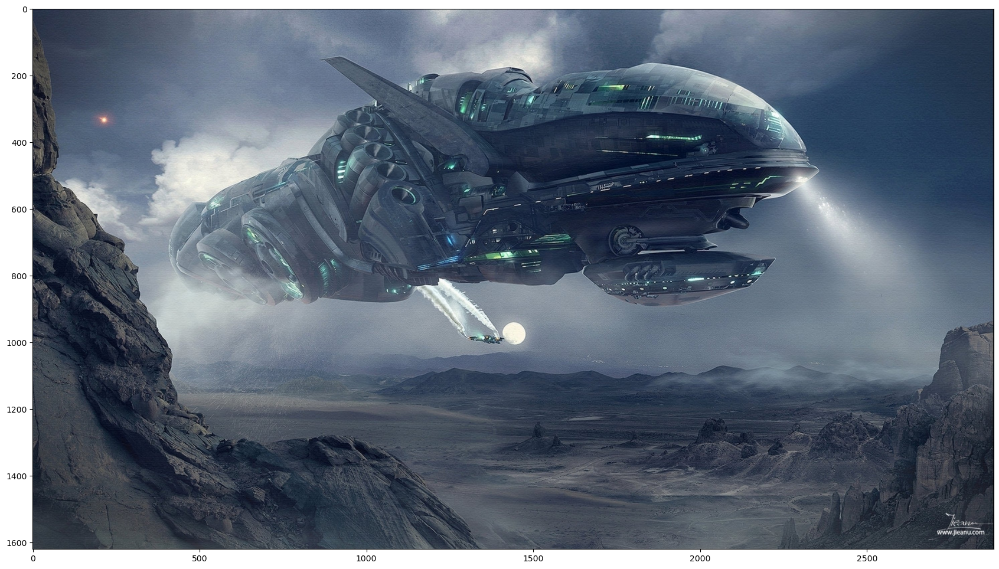

In [60]:
## Display the Sharp Image 
import matplotlib.pyplot as plt
from PIL import Image

# Open the image file
sharp_image = Image.open("./Example_Images/Sharp_Image.jpg")

# Set the figure size
plt.figure(figsize=(21,21))

# Display the image
plt.imshow(sharp_image)
plt.show()

**`1. Basic Blur`**

* This is a `simple blur` technique that `softens an image by blending the colors` of pixels near significant transitions or edges. It's often `used to hide imperfections` or soften an image.

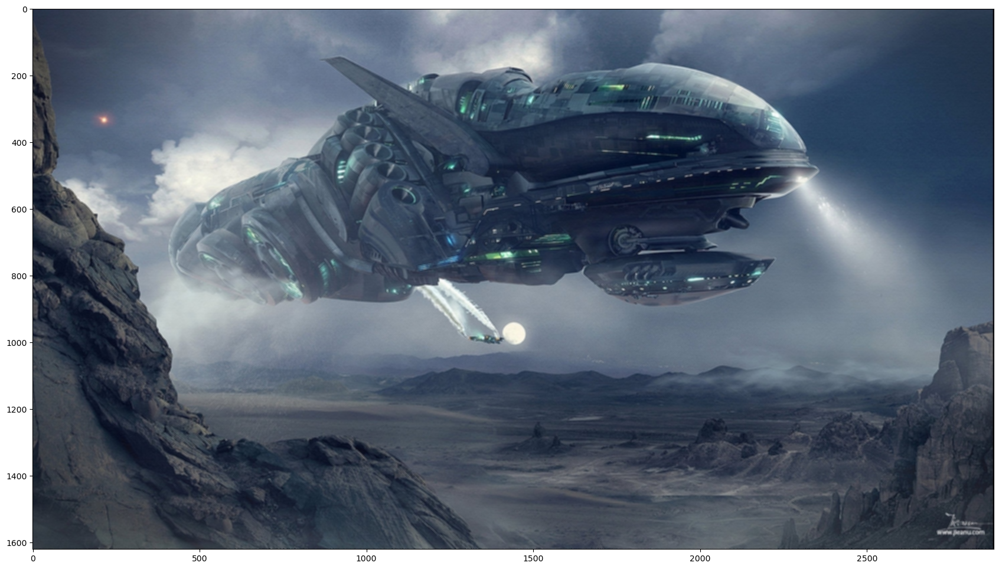

In [61]:
from PIL import Image, ImageFilter

# Open an image
sharp_image = Image.open("./Example_Images/Sharp_Image.jpg")

# Apply the blur
basic_blur_image = sharp_image.filter(ImageFilter.BLUR)

# Save the image to a file
basic_blur_image.save('./Example_Images/Basic_Blur_Image.jpg')

# Set the figure size
plt.figure(figsize=(21,21))

# Display the image
plt.imshow(basic_blur_image)
plt.show()

**`2. Gaussian Blur`**

* Named after the German mathematician Karl Fredrich Gauss, this blur is `created using a specific mathematical algorithm`. It's a popular technique because it provides a `natural-looking blur`.

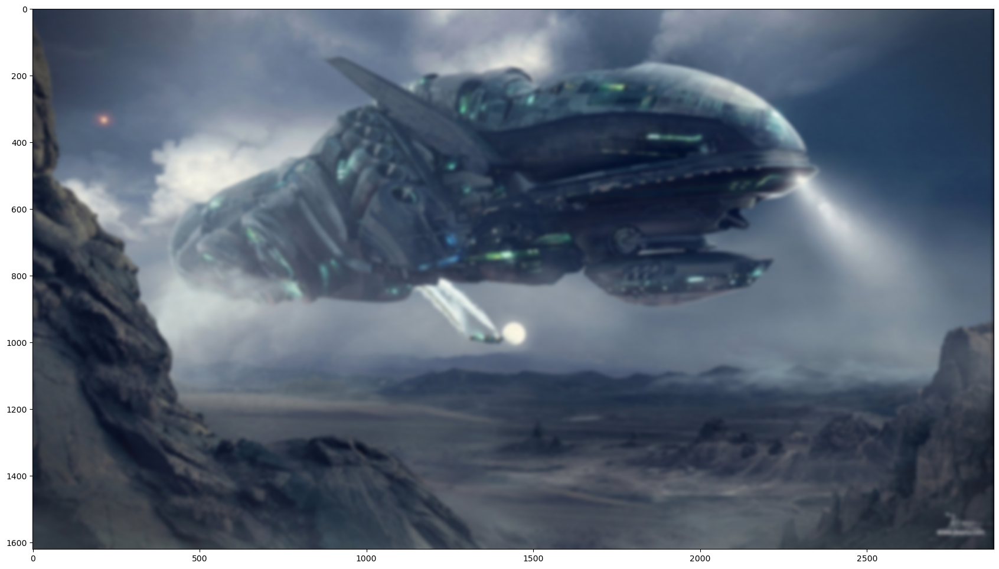

In [62]:
from PIL import Image, ImageFilter

# Open an image
sharp_image = Image.open("./Example_Images/Sharp_Image.jpg")

# Blur the image
gaussian_blur_image = sharp_image.filter(ImageFilter.GaussianBlur(5))

# Save the blurred image
gaussian_blur_image.save("./Example_Images/Gaussian_Blur_Image.jpg")

# Set the figure size
plt.figure(figsize=(21,21))

# Display the image
plt.imshow(gaussian_blur_image)
plt.show()

**`3. Motion Blur`**

* This filter creates a `directional blur` to imitate the effect you would get if an object was `moving rapidly` in front of your camera. It's `useful when you want to suggest motion` in a static image.

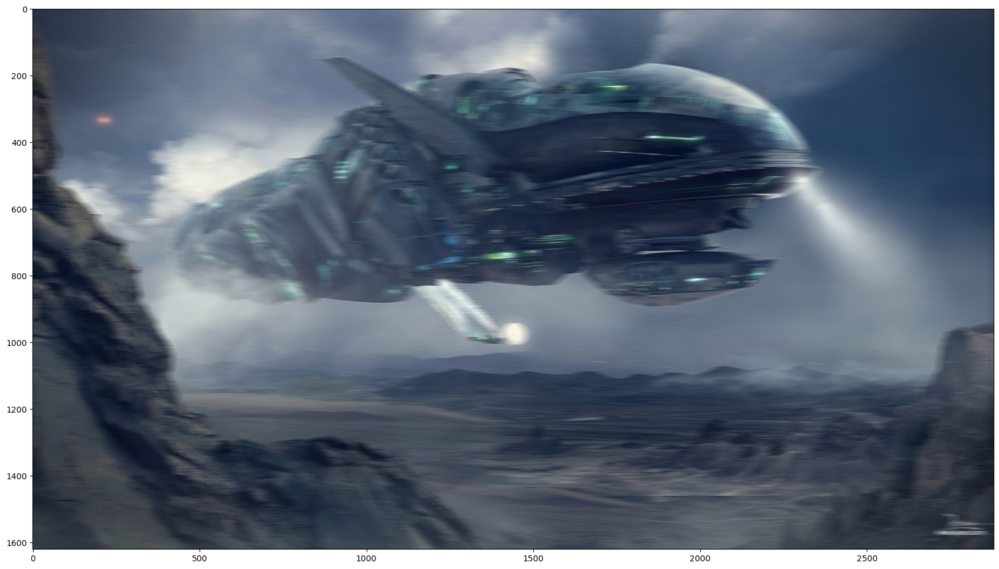

In [63]:
import cv2
import numpy as np

# Load image:
sharp_image = cv2.imread("./Example_Images/Sharp_Image.jpg")

# Create kernel for motion blur:
size = 36
kernel_motion_blur = np.zeros((size, size))
kernel_motion_blur[int((size-1)/2), :] = np.ones(size)
kernel_motion_blur = kernel_motion_blur / size

# Apply the kernel to blur the image:
motion_blur_image = cv2.filter2D(sharp_image, -1, kernel_motion_blur)

# Save the image:
cv2.imwrite("./Example_Images/Motion_Blur_Image.jpg", motion_blur_image)

# Convert the image from BGR to RGB format
motion_blur_image = cv2.cvtColor(motion_blur_image, cv2.COLOR_BGR2RGB)

# Set the figure size
plt.figure(figsize=(21,21))

# Display the image
plt.imshow(motion_blur_image)
plt.show()

**`4. Box Blur`** 

* This technique blurs an image by `averaging the colors of nearby pixels`. It provides more control than the basic blur filter and `retains more definition` in an image, but it can create a distortion. It's often `used for special effects`.

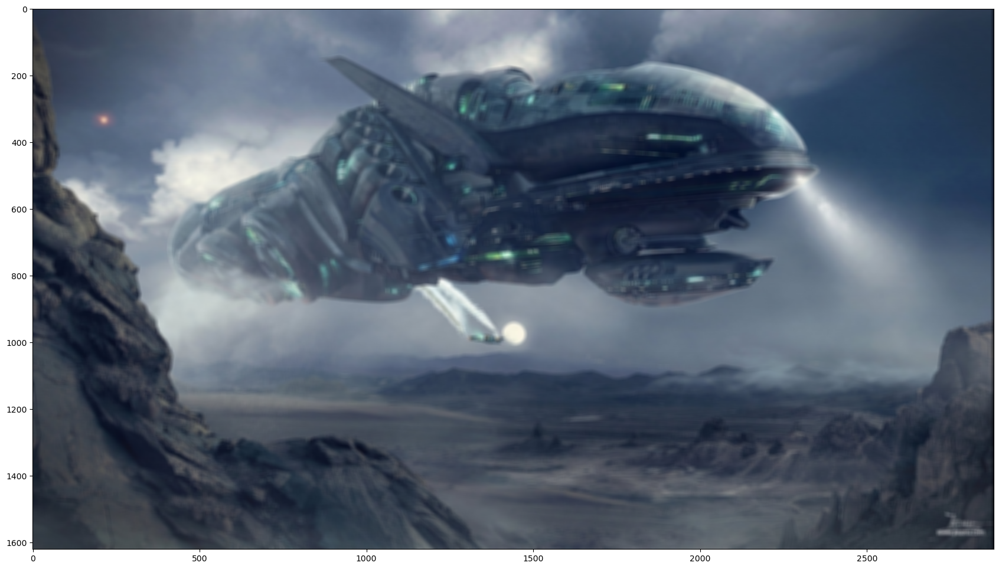

In [65]:
from PIL import Image, ImageFilter

# Open an image
sharp_image = Image.open("./Example_Images/Sharp_Image.jpg")

# Blur the image
box_blur_image = sharp_image.filter(ImageFilter.BoxBlur(7))

# Save the blurred image
box_blur_image.save("./Example_Images/Box_Blur_Image.jpg")

# Set the figure size
plt.figure(figsize=(21,21))

# Display the image
plt.imshow(box_blur_image)
plt.show()

**`5. Tilt Shift`**

* This filter `prevents perspective distortion by controlling the plane of focus`. It's sometimes also used to make an image look as though it was `shot up close with a macro lens`, making the `subjects look like mini versions` of themselves.

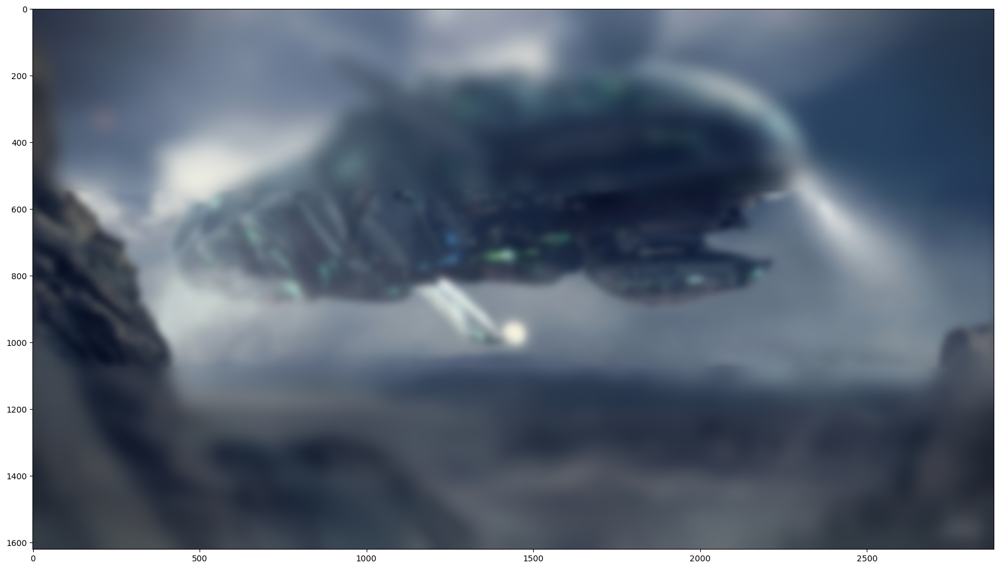

In [66]:
import numpy as np
import cv2

    
# Load the image
sharp_image = cv2.imread("./Example_Images/Sharp_Image.jpg")
    
# Apply the first blur
blurred1 = cv2.GaussianBlur(sharp_image, (0, 0), 11)
    
# Apply the second blur
blurred2 = cv2.GaussianBlur(sharp_image, (0, 0), 26)
    
# Create a mask
rows, cols = sharp_image.shape[:2]
mask = np.zeros((rows, cols), dtype=np.uint8)
mask[rows//3 : 2*rows//3, :] = 1
    
# Combine the blurred images
tilt_shift_image = cv2.seamlessClone(np.uint8(blurred1), np.uint8(blurred2), mask*255, (cols//2, rows//2), cv2.NORMAL_CLONE)

# Save the image:
cv2.imwrite("./Example_Images/Tilt_Shift_Image.jpg", tilt_shift_image)

# Convert the image from BGR to RGB format
tilt_shift_image = cv2.cvtColor(tilt_shift_image, cv2.COLOR_BGR2RGB)

# Set the figure size
plt.figure(figsize=(21,21))

# Display the image
plt.imshow(tilt_shift_image)
plt.show()

**`6. Bilateral Blurring`**

* Bilateral blurring is a technique that `reduces noise in an image while keeping the edges sharp`. It's often `used as a pre-processing step in computer vision` and image processing tasks to improve the results of subsequent operations.

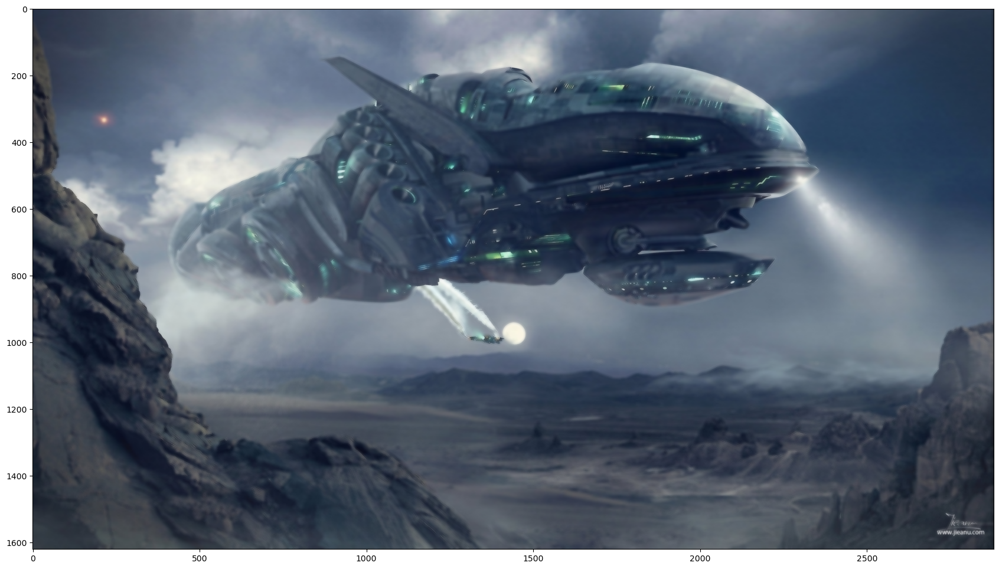

In [67]:
import cv2 # Importing opencv
import os # Importing os for directory operations

# Load the image
sharp_image = cv2.imread("./Example_Images/Sharp_Image.jpg")

# define bilateral blur parameters
d = 15 # Diameter of each pixel neighborhood that is used during filtering. 
sigmaColor = 225 # Filter sigma in the color space.
sigmaSpace = 225 # Filter sigma in the coordinate space.

# perform bilateral blur
bilateral_blur_image = cv2.bilateralFilter(sharp_image, d, sigmaColor, sigmaSpace)

# Save the image:
cv2.imwrite("./Example_Images/Bilateral_Blur_Image.jpg", bilateral_blur_image)

# Convert the image from BGR to RGB format
bilateral_blur_image = cv2.cvtColor(bilateral_blur_image, cv2.COLOR_BGR2RGB)

# Set the figure size
plt.figure(figsize=(21,21))

# Display the image
plt.imshow(bilateral_blur_image)
plt.show()

* Each of these blur types has its own `use cases` and effects on images. The choice of blur type depends on the specific requirements of your image processing task.
* We will create a `dataset` with all of these types of blurs.

#### **Step 1. Download Sharp Images**

* The first step to create this dataset is to `download sharp images` from a range of `diverse topics`.
* We will use `bing-image-downloader` for this.
* `pip install bing-image-downloader`


'''

* Below is the code to `download images` using a `keyword`.

In [2]:
from bing_image_downloader import downloader

downloader.download(
    query="Puppies", 
    limit=5,  
    output_dir="./Example_Images/", 
    adult_filter_off=True, 
    force_replace=False, 
    timeout=60, 
    verbose=True
)

[%] Downloading Images to c:\Users\Sanskar\AI\AI_work\Computer_Vision___Image_Deblurring_using_Deep_Learning\Example_Images\Downloaded\Puppies


[!!]Indexing page: 1

[%] Indexed 5 Images on Page 1.


[%] Downloading Image #1 from http://3.bp.blogspot.com/-1y_qEJoKtQc/UXOM88YLX1I/AAAAAAAAIiw/hXpNLVBxX7g/s1600/best+puppies+picture54.jpg
[!] Issue getting: http://3.bp.blogspot.com/-1y_qEJoKtQc/UXOM88YLX1I/AAAAAAAAIiw/hXpNLVBxX7g/s1600/best+puppies+picture54.jpg
[!] Error:: HTTP Error 404: Not Found
[%] Downloading Image #1 from https://www.rd.com/wp-content/uploads/2021/03/GettyImages-1133605325-scaled-e1617227898456.jpg
[%] File Downloaded !

[%] Downloading Image #2 from http://www.iheartteacups.com/wp-content/uploads/2017/11/IMG_6958.jpg
[%] File Downloaded !

[%] Downloading Image #3 from http://4.bp.blogspot.com/-a2ADYMu0TSo/UZGYNURy4wI/AAAAAAAADdk/r8LUpQx3z1o/s1600/Cute-puppies+(1).jpg
[%] File Downloaded !

[%] Downloading Image #4 from http://3.bp.blogspot.com/-JKUktgJ3LxE/T6TI4E

**Keywords**

* We will use these keywords to `download images`.

In [1]:
keywords = ['airports', 'basketball', 'beaches', 'birds', 'birthday', 'burgers', 'cake', 
             'camera', 'cats', 'charts', 'children', 'cities', 'computer', 'dogs', 'elephants', 
             'exercise', 'family', 'forests', 'friends', 'fruits', 'golf', 'graduation', 
             'group', 'gym', 'headphones', 'healthy food', 'holidays', 'horses', 'landmarks', 'landscapes', 
             'laptop', 'lions', 'meditation', 'meeting', 'men', 'money', 'monuments', 
             'mountains', 'office', 'pasta', 'pizza', 'portraits', 'resorts', 'rivers', 'running', 
             'skiing', 'smartphone', 'soccer', 'surfing', 'sushi', 'swimming', 'tablet', 
             'teamwork', 'tennis', 'tigers', 'vegetables', 'waterfalls', 'wedding', 'women', 'yoga']

len(keywords)

60

**Downloading Images**

In [4]:
from bing_image_downloader import downloader

for keyword in keywords:
    downloader.download(
                        query=keyword, 
                        limit=100,  
                        output_dir="./Downloaded_Images/", 
                        adult_filter_off=True, 
                        force_replace=False, 
                        timeout=60, 
                        verbose=True
)

[%] Downloading Images to c:\Users\Sanskar\AI\AI_work\Computer_Vision___Image_Deblurring_using_Deep_Learning\Downloaded_Images\gym


[!!]Indexing page: 1

[%] Indexed 35 Images on Page 1.


[%] Downloading Image #1 from http://blog.safetykart.com/wp-content/uploads/2018/01/TheMacauRoosevelt_TheGym.jpg
[%] File Downloaded !

[%] Downloading Image #2 from https://muscletraining.org.uk/wp-content/uploads/2013/10/wpid-gym3.jpg
[%] File Downloaded !

[%] Downloading Image #3 from https://fm.cnbc.com/applications/cnbc.com/resources/img/editorial/2015/05/20/102693152-Gravity_-_The_Gym.1910x1000.jpg
[%] File Downloaded !

[%] Downloading Image #4 from https://www.city-data.com/forum/attachments/exercise-fitness/222299d1595443592-gyms-safe-study-confirms-gym.jpg
[%] File Downloaded !

[%] Downloading Image #5 from https://www.arrayasolutions.com/wp-content/uploads/2017/09/graphicstock-dumbbells-in-the-gym_rOrb1nwlil.jpg
[!] Issue getting: https://www.arrayasolutions.com/wp-content/uploads/2017/

#### **Step 2. Train-Test Split**

* Now that we have downloaded a total of `6000 sharp images`, we will `group` them all in one folder and then `split` them into `4200-1800` set of images as `Train-Test set`.

**`Grouping and Renaming all Images`**

* We will `group all images` into one folder and `rename them as numbers`.

In [5]:
import os
import shutil

# Path where the images are currently stored
parent_dir = "./Downloaded_Images/"
# Path where the images will be sent
destination_dir = "./Downloaded_Images/All_Images/"

# if the directory doesn't exist, create it
if not os.path.exists(destination_dir): 
    os.makedirs(destination_dir)

counter = 1

# The subdirectory based on the keywords of the downloaded images
for subdir in os.listdir(parent_dir):   

    # Recheck if the path of the folder (subdirectory) matches
    if os.path.isdir(parent_dir + subdir):

        # The images stored in those subdirectory
        for image in os.listdir(parent_dir + subdir):

            # use counter to create a new image name with an extension
            new_name = str(counter) + ".jpg" 
                
            # The directory the image is currently in
            source = parent_dir + subdir + "/" + image

            # The directory the image will be stored in 
            destination = destination_dir + new_name

            # move the file
            shutil.move(source, destination)  

            # increment the counter
            counter += 1  


**`Train-Test Split`**

* Now we will `split` all the images into `4200-1800` set of images as `Train-Test set`.
* And we will store them as `Sharp Images` in respective `set folders`.

In [6]:
import os
import shutil
import random

source_dir = "./Downloaded_Images/All_Images"
dest_dirs = {"Train": "./Images/Train/Sharp_Images",
             "Test": "./Images/Test/Sharp_Images"}

# Create the directories if they don't exist
for dir in dest_dirs.values():
    if not os.path.exists(dir):
        os.makedirs(dir)

# List all files in source directory and shuffle them
images = os.listdir(source_dir)
random.shuffle(images)

# Now calculate the index values for 70%, 30%
train_idx = int(len(images) * 0.7)

# Finally move images to each directory
for i, image in enumerate(images):
    if i < train_idx:
        shutil.move(os.path.join(source_dir, image), os.path.join(dest_dirs['Train'], image))
    else:
        shutil.move(os.path.join(source_dir, image), os.path.join(dest_dirs['Test'], image))


#### **Step 3. Apply Blurs** 

* Now we will `randomly` apply `one of the types of blurs to each image` and save them in corresponding set's `Blur directory`.
* First, we will start by `resizing all the images` to one size, then create `functions` for applying each type of `blur` to the images.

**`Resizing Images and removing non-RGB Images`**

In [3]:
import os
from PIL import Image

def resize_images(folder_path):
    # List comprehension to get all .jpg files in the specified folder
    filenames = [f for f in os.listdir(folder_path) if f.endswith('.jpg')]
    
    for filename in filenames:
        # Joining the folder path and filename to create the full file path
        file_path = os.path.join(folder_path, filename)
        # Initializing a flag to False which will be used to determine whether to remove an image or not
        remove_image = False
        
        # Opening the image file
        with Image.open(file_path) as img:
            # Checking if the image is not in RGB mode
            if img.mode != "RGB":
                # Printing a message that a non-RGB image has been detected and will be removed
                print(f'Non-RGB image detected and will be removed: {filename}')
                # Setting the flag to True to remove the image
                remove_image = True
            else:
                img = img.resize((480, 480))
                img.save(file_path)
        
        if remove_image:
            os.remove(file_path)

        
            
resize_images("./Images/Train/Sharp_Images/")
resize_images("./Images/Test/Sharp_Images/")

Non-RGB image detected and will be removed: 100.jpg
Non-RGB image detected and will be removed: 1010.jpg
Non-RGB image detected and will be removed: 1053.jpg
Non-RGB image detected and will be removed: 1055.jpg
Non-RGB image detected and will be removed: 1056.jpg
Non-RGB image detected and will be removed: 1062.jpg
Non-RGB image detected and will be removed: 1066.jpg
Non-RGB image detected and will be removed: 1069.jpg
Non-RGB image detected and will be removed: 1071.jpg
Non-RGB image detected and will be removed: 1085.jpg
Non-RGB image detected and will be removed: 1098.jpg
Non-RGB image detected and will be removed: 1101.jpg
Non-RGB image detected and will be removed: 1138.jpg
Non-RGB image detected and will be removed: 1155.jpg
Non-RGB image detected and will be removed: 1163.jpg
Non-RGB image detected and will be removed: 117.jpg
Non-RGB image detected and will be removed: 1173.jpg
Non-RGB image detected and will be removed: 1213.jpg
Non-RGB image detected and will be removed: 1224

**`Reindexing Images`**

In [4]:
import os
import shutil

def rename_and_move_images(source_dir, dest_dir):
    # Make sure source_dir and dest_dir end with '/'
    if not source_dir.endswith('/'): 
        source_dir += '/'
   
    if not dest_dir.endswith('/'): 
        dest_dir += '/'
   
    # If dest_dir doesn't exist create the directory
    if not os.path.exists(dest_dir):
        os.makedirs(dest_dir)

    # List comprehension to get all files in the source directory
    files = [f for f in os.listdir(source_dir) if os.path.isfile(source_dir + f)]
    
    # Creating the full file name by joining the source directory and file name
    for i, file_name in enumerate(files):
        full_file_name = source_dir + file_name
        # If the full file name is a file move the file to the destination directory 
        # and rename it with the index
        if os.path.isfile(full_file_name):
            shutil.move(full_file_name, "{}{}.jpg".format(dest_dir, i))


train_source_dir = './Images/Train/Sharp_Images/'
train_dest_dir = './Images/Train/sharp/'

test_source_dir = './Images/Test/Sharp_Images/'
test_dest_dir = './Images/Test/sharp/'


rename_and_move_images(train_source_dir, train_dest_dir)
rename_and_move_images(test_source_dir, test_dest_dir)

**`Functions for Applying Blur and Saving the Image`**

In [1]:
import os
import cv2
import random
import numpy as np
from PIL import Image, ImageFilter

random.seed=42

def Basic_Blur(source, destination):
    sharp_image = Image.open(source)
    basic_blur_image = sharp_image.filter(ImageFilter.BLUR)
    basic_blur_image.save(destination)

def Gaussian_Blur(source, destination):
    sharp_image = Image.open(source)
    gaussian_blur_image = sharp_image.filter(ImageFilter.GaussianBlur(5))
    gaussian_blur_image.save(destination)

def Motion_Blur(source, destination):
    sharp_image = cv2.imread(source)
    size=36
    kernel_motion_blur = np.zeros((size, size))
    kernel_motion_blur[int((size-1)/2), :] = np.ones(size)
    kernel_motion_blur = kernel_motion_blur / size
    motion_blur_image = cv2.filter2D(sharp_image, -1, kernel_motion_blur)
    cv2.imwrite(destination, motion_blur_image)

def Box_Blur(source, destination):
    sharp_image = Image.open(source)
    box_blur_image = sharp_image.filter(ImageFilter.BoxBlur(7))
    box_blur_image.save(destination)

def Tilt_shift(source, destination):
    sharp_image = cv2.imread(source)
    blurred1 = cv2.GaussianBlur(sharp_image, (0, 0), 11)
    blurred2 = cv2.GaussianBlur(sharp_image, (0, 0), 26)
    rows, cols = sharp_image.shape[:2]
    mask = np.zeros((rows, cols), dtype=np.uint8)
    mask[rows//3 : 2*rows//3, :] = 1
    tilt_shift_image = cv2.seamlessClone(np.uint8(blurred1), np.uint8(blurred2), mask*255, (cols//2, rows//2), cv2.NORMAL_CLONE)
    cv2.imwrite(destination, tilt_shift_image)

def Bilateral_Blur(source, destination):
    sharp_image = cv2.imread(source)
    d=15
    sigmaColor=225 
    sigmaSpace=225 
    bilateral_blur_image = cv2.bilateralFilter(sharp_image, d, sigmaColor, sigmaSpace)
    cv2.imwrite(destination, bilateral_blur_image)


functions = [Basic_Blur, Gaussian_Blur, Motion_Blur, Box_Blur, Tilt_shift, Bilateral_Blur]

**`Randomly Applying Blur functions to the copy of each Image and Saving the Image`**

In [2]:
def Random_Blur(sharp_images_dir, blur_images_dir):

    # use os.listdir to get a list of all files in the directory
    sharp_images_list = os.listdir(sharp_images_dir)

    # filter out directories; keep files only, using os.path.isfile
    sharp_images_name_list = [f for f in sharp_images_list if os.path.isfile(os.path.join(sharp_images_dir, f))]

    # use for loop to apply a random blur function
    for image_name in sharp_images_name_list:
        source = sharp_images_dir + image_name
        destination = blur_images_dir + image_name
        random.choice(functions)(source=source, destination=destination)

In [3]:
# Train Sharp and Blur Images Directory
Train_sharp_dir = "./Images/Train/sharp/"
Train_blur_dir = "./Images/Train/blur/"

# Test Sharp and Blur Images Directory
Test_sharp_dir = "./Images/Test/sharp/"
Test_blur_dir = "./Images/Test/blur/"

In [4]:
Random_Blur(sharp_images_dir=Train_sharp_dir, blur_images_dir=Train_blur_dir)
Random_Blur(sharp_images_dir=Test_sharp_dir, blur_images_dir=Test_blur_dir)

* Now that we have our `Image Deblurring Dataset` complete, we are ready to train a `Deep Learning Neuron Network Model` on it.

***
***

### **B. DCGAN Deep Learning Model**

> `DCGAN` stands for `Deep Convolutional Generative Adversarial Networks (DCGAN)`.

**GAN**

* A `GAN (Generative Adversarial Network)` is a framework for teaching a `deep learning model` to capture the training data distribution so we can `generate new data from that same distribution`. 

* `GAN`s are made of `two` distinct models, a `generator` and a `discriminator`. The job of the `generator` is to `spawn ‘fake’ images` that look like the training images. The job of the `discriminator` is to look at an image and `output whether` or not it is a `real training image` or a `fake image` from the generator.

![GAN](https://iq.opengenus.org/content/images/2022/07/1.jpg)

**DCGAN**

* A `DCGAN (Deep Convolutional Generative Adversarial Network)` is a direct extension of the `GAN` described above, except that it explicitly uses `convolutional and convolutional-transpose layers` in the discriminator and generator, `respectively`. 

![DCGAN](https://iq.opengenus.org/content/images/2022/07/5.jpg)

* We will build from scratch a `DCGAN` model and use it for our `Image Deblurring` tasks.

'''

**Import Libraries**

In [1]:
import tensorflow as tf
from tensorflow import pad, random_normal_initializer, reduce_mean, square, ones_like, zeros_like
from tensorflow.keras.layers import Layer, Add, Conv2D, BatchNormalization, InputSpec, concatenate
from tensorflow.keras.layers import Dropout, UpSampling2D, Input, Lambda, LeakyReLU, ZeroPadding2D
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.optimizers import Adam

import os
import pathlib
import time
import datetime
from matplotlib import pyplot as plt
from IPython import display

**Hyper-parameters**

* We will set some `hyper-parameters` in advanced that we will be using in building our model.
    
    * `Image Size`: 
        * `IMG_HEIGHT` AND `IMG_WIDTH` represent the `resolution` of our input `images`.
        * `OUTPUT_CHANNELS` tells the number of `color channels`, in this case `RGB (Red, Green, Blue)`.
    * `Constant in Generator Loss Function`: 
        * `Lambda` is a simple `constant` that controls the `weight` of different `loss terms` in the `custom loss function` for the generator.

In [2]:
# image size
IMG_WIDTH = 256
IMG_HEIGHT = 256
OUTPUT_CHANNELS = 3

# constant in generator loss function
LAMBDA = 100

#### **`Generator`**

> A **Generator** in a Deep Convolutional Generative Adversarial Network `(DCGAN)` is a neural network that `creates new, synthetic data that resembles the real data it was trained on`. 

* It does this by `taking in random input`, called noise, and transforming it through multiple layers into an `output that looks like a sample from the real data`. 

* The generator is `trained alongside` another neural network called the `discriminator`, which tries to `distinguish between the real data and the synthetic data` created by the generator. 

* The `generator's goal` is to create data that can `fool the discriminator` into thinking it is real.

Before we create our **Generator**, we need to create a `Reflection Padding` and a `Residual Block`.

'''

##### **`Reflection Padding`**

> A `ReflectionPadding2D` layer in a `generator` of a Deep Convolutional Generative Adversarial Network (DCGAN) is a layer that `adds padding to the edges of an image` by reflecting the image along its boundaries. 

* This means that the `pixels along the edge of the image are mirrored`, creating a seamless transition between the original image and the padded region. 

* This type of padding can help to `preserve the continuity of image features` and reduce artifacts that might arise from other types of padding. It is used in the generator to `prepare the input for a convolutional layer`, allowing the convolutional kernel to operate on the entire input image, including its edges.

In [3]:
class ReflectionPadding2D(Layer):
    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        self.input_spec = [InputSpec(ndim=4)]
        super(ReflectionPadding2D, self).__init__(**kwargs)

    def compute_output_shape(self, s):
        return (s[0], s[1] + 2 * self.padding[0], s[2] + 2 * self.padding[1], s[3])

    def call(self, x, mask=None):
        w_pad,h_pad = self.padding
        return pad(x, [[0,0], [h_pad,h_pad], [w_pad,w_pad], [0,0] ], 'REFLECT')

**Code Explained**

> This code defines a custom `ReflectionPadding2D layer` in Keras. The layer takes as input a `4D tensor representing a batch of images`, and applies `reflection padding` to the second and third dimensions of the tensor, corresponding to the `height and width of the images`.

* The `__init__` method `initializes the layer` by taking as `input` a padding argument, which is a `tuple specifying the amount of padding` to add along the height and width dimensions of the input tensor. The method also sets the input_spec attribute to specify that the layer expects a 4D input tensor.

* The `compute_output_shape` method `calculates the shape of the output tensor` by adding twice the padding amount to the second and third dimensions of the input shape.

* The `call` method `applies reflection padding to the input tensor` using the pad function from TensorFlow. The padding is applied along the second and third dimensions of the tensor, with a padding amount specified by the self.padding attribute. The `'REFLECT'` argument specifies that `reflection padding` should be used.

Overall, this layer can be used to add reflection padding to a batch of images, which can be useful in image processing tasks such as training a DCGAN.

'''

##### **`Residual Block`**

> A `Residual Block` is a type of neural network layer that consists of a `series of convolutional layers`, `followed by an element-wise addition operation` that adds the input of the block to its output. This allows the block to learn a `residual function`, which represents the `difference between the input and the desired output`.

* In the context of a `generator` in a `DCGAN`, a residual block can be used to `improve the ability of the generator` to model complex data distributions. 

* By including residual connections, the `generator can more easily learn` to preserve low-level details in the input data, while also being able to `generate high-level features`. 

* This can help to `improve the quality` of the generated images and `reduce artifacts` such as blurring or distortion.

In [4]:
def res_net(input, filters, kernel_size, strides=(1, 1), apply_dropout=False):
  initializer = random_normal_initializer(0., 0.02)

  x = ReflectionPadding2D(padding=(1,1))(input)
  x = Conv2D(filters=filters, kernel_size=kernel_size, kernel_initializer=initializer, strides=strides)(x)
  x = BatchNormalization()(x)
  x = tf.nn.relu(x)

  if apply_dropout:
    x = Dropout(0.5)(x)

  x = ReflectionPadding2D(padding=(1,1))(x)
  x = Conv2D(filters=filters, kernel_size=kernel_size, kernel_initializer=initializer, strides=strides)(x)
  x = BatchNormalization()(x)

  merged = Add()([input, x])
  return merged

**Code Explained**

> This code defines a function `res_net` that implements a residual block for a convolutional neural network. The function takes as `input a tensor, representing the input to the block`, as well as several arguments specifying the `number of filters, kernel size, and strides` for the convolutional layers in the block. The function also takes an optional argument `apply_dropout`, which specifies whether or not to apply dropout regularization to the block.

* The function begins by applying `reflection padding to the input tensor` using a ReflectionPadding2D layer. This is followed by a Conv2D layer that applies a `convolutional operation to the padded input`, using the specified number of filters, kernel size, and strides. The output of the convolutional layer is then passed through a `BatchNormalization` layer and a `ReLU activation function`.

* If the `apply_dropout` argument is set to `True`, the function applies `dropout regularization` to the output of the ReLU activation using a Dropout layer with a rate of 0.5.

* The function then applies `another round` of reflection padding, convolution, and batch normalization to the output of the dropout layer (or the ReLU activation if dropout is not applied). Finally, the function `adds the original input tensor to the output` of the second batch normalization layer using an Add layer, and returns the result.

This `residual block` can be used in a convolutional neural network to `learn a residual function` that represents the difference between its input and output. By including this residual connection, the block can more easily learn to preserve low-level details in the input data while also being able to generate high-level features.

'''

##### **`Generator Model`**

* Below we finally build our `Generator` model using the `Reflection Padding` layer and the `Residual Block` we created earlier.

In [5]:
def Generator():
  initializer = random_normal_initializer(0., 0.02)
  inputs = Input(shape=[256, 256, 3])

  # 7x7 Conv n64
  x = ReflectionPadding2D(padding=(3,3))(inputs)
  x = Conv2D(64, kernel_size=(7,7), padding='valid', kernel_initializer=initializer)(x)
  x = BatchNormalization()(x)
  x = tf.nn.relu(x)

  # 3x3 Conv n128s2
  x = Conv2D(128, kernel_size=(3,3), padding='same', strides=2, kernel_initializer=initializer)(x)
  x = BatchNormalization()(x)
  x = tf.nn.relu(x)

  # 3x3 Conv n256s2
  x = Conv2D(256, kernel_size=(3,3), padding='same', strides=2, kernel_initializer=initializer)(x)
  x = BatchNormalization()(x)
  x = tf.nn.relu(x)

  # 9 resnet blocks n256
  for _ in range(9):
    x = res_net(x, 256, kernel_size=(3,3), apply_dropout=True)

  # unsampling n128
  x = UpSampling2D(interpolation='bilinear')(x)
  x = Conv2D(128, kernel_size=(3,3), padding='same', kernel_initializer=initializer)(x)
  x = BatchNormalization()(x)
  x = tf.nn.relu(x)

  # unsampling n64
  x = UpSampling2D(interpolation='bilinear')(x)
  x = Conv2D(64, kernel_size=(3,3), padding='same', kernel_initializer=initializer)(x)
  x = BatchNormalization()(x)
  x = tf.nn.relu(x)

  # 7x7 Conv n64
  x = ReflectionPadding2D(padding=(3,3))(x)
  x = Conv2D(filters=OUTPUT_CHANNELS, kernel_size=(7,7), padding='valid', kernel_initializer=initializer)(x)
  x = tf.nn.tanh(x)
 
  outputs = Add()([x, inputs])
  outputs = Lambda(lambda z: z/2)(outputs)

  model = Model(inputs=inputs, outputs=outputs, name='Generator')
  return model

**Code Explained**

> This code defines a function `Generator` that creates a `Keras model` representing a generator for a `DCGAN`. The generator takes as input a batch of images with shape `[256, 256, 3]`, and produces an output tensor of the same shape.

* The generator consists of several layers of `convolutional and upsampling operations`, as well as a series of `residual blocks` implemented using the `res_net function` defined earlier. The generator begins by applying `reflection padding` to the input tensor, followed by a `Conv2D layer with 64 filters and a kernel size of 7x7`. * The output of the convolutional layer is then passed through a `BatchNormalization` layer and a `ReLU` activation function.

* The generator then applies `2` more rounds of `convolution, batch normalization, and ReLU activation`, using Conv2D layers with `128 and 256 filters`, respectively, and `kernel size of 3x3`. These convolutional layers use a `stride of 2` to `downsample` the input tensor.

* Next, the generator applies `9 residual blocks` to the output of the last convolutional layer. Each residual block consists of `1` convolutional layers with `256 filters and kernel size of 3x3`, separated by `Batch Normalization` and `ReLU` activation. `Dropout regularization` is applied to each residual block.

* After the residual blocks, the generator applies `2` rounds of `upsampling` using UpSampling2D layers with bilinear interpolation. Each upsampling layer is followed by `1` Conv2D layer with `128 or 64 filters`, respectively, and `kernel size of 3x3`. The output of each convolutional layer is passed through `Batch Normalization` and `ReLU` activation.

* Finally, the generator applies another round of `reflection padding` and `convolution` using a Conv2D layer with `OUTPUT_CHANNELS filters` and `kernel size of 7x7`. The output of this convolutional layer is passed through a `tanh` activation function to produce the final output tensor.

* The generator then `adds` the original input tensor to its output using an Add layer, and `scales the result` by a factor of `0.5` using a Lambda layer. This produces the final output tensor for the generator.

The function returns a `Keras Model` object representing the generator, with inputs specified by the inputs tensor and outputs specified by the outputs tensor.

* Next, we create an instance of the `generator model` defined by the `Generator function`. 

In [6]:
generator = Generator()

* Now we will make our `custom loss functions` for Generator.

'''

#### **`Generator Loss Functions`**

> The `generator loss function` is used to measure how well the generator is able to `create synthetic data` that can `fool the discriminator` into thinking it is real. The generator loss function takes as `input` the `output of the discriminator` for the synthetic data generated by the generator, and calculates a `scalar value representing the loss`.

* We will use `Perceptual Loss` for our `Generator Loss Function`.

**`Perceptual Loss`**

> `Perceptual loss`, also known as `feature loss` or `VGG loss`, is a type of loss function that is used in some generative models to measure the `perceptual similarity between two images`. It is not commonly used in `DCGAN`s.

* `Perceptual loss` is calculated by `comparing the high-level features extracted from two images` by a `pre-trained` convolutional neural network, such as the `VGG` network. The idea is that two images that are perceptually similar should have similar high-level features, even if their pixel values are different.

In [7]:
# pre-trained model for the perceptual loss function
vgg = VGG16(include_top=False, weights='imagenet', input_shape=(256,256,3))
loss_model = Model(inputs=vgg.input, outputs=vgg.get_layer('block3_conv3').output)
loss_model.trainable = False

In [8]:
def perceptual_loss(y_true, y_pred):
  return reduce_mean(square(loss_model(y_true) - loss_model(y_pred)))

In [9]:
def generator_loss(disc_generated_output, gen_output, target):

  gan_loss = -reduce_mean(disc_generated_output)
  l2_loss = perceptual_loss(target, gen_output)

  total_gen_loss = gan_loss + LAMBDA*l2_loss
  return total_gen_loss, gan_loss, l2_loss

**Code Explained**

* This code defines a `custom generator loss function` for a `DCGAN` that includes a `perceptual loss term`. The code begins by creating an instance of the `VGG16 model`, pre-trained on the ImageNet dataset, and setting its include_top argument to False to exclude the final fully-connected layers. The input shape of the VGG16 model is set to `(256,256,3)` to match the shape of the `input images`.

* The code then creates a `loss_model` by taking the output of the `block3_conv3` layer of the `VGG16` model, which represents the `high-level features` extracted from the input images. The loss_model is set to be `non-trainable`, so that its weights are not updated during training.

* The `perceptual_loss` function is defined to take as `input two tensors` representing the `target and predicted images`, respectively. The function calculates the perceptual loss by passing both tensors through the loss_model, which extracts their `high-level features`, and then calculating the `mean squared error` between the extracted features.

* The `generator_loss` function takes as input `three tensors` representing the `output of the discriminator` for the synthetic data generated by the generator (disc_generated_output), `the synthetic data` itself (gen_output), and `the target data` (target). The function calculates the generator loss as a `weighted sum of two terms: a GAN loss term`, calculated as the `negative mean of disc_generated_output`, and a `perceptual loss` term, calculated using the `perceptual_loss function` defined earlier. The relative importance of these two terms is controlled by a hyperparameter `LAMBDA`, which specifies how much `weight` to give to the perceptual loss term.

The generator_loss function returns `3` values: the `total generator loss`, calculated as the sum of the GAN loss and perceptual loss terms; `the GAN loss`; and the `perceptual loss`.

'''

#### **`Discriminator`**

> The `Discriminator` is one of the two distinct models in a `DCGAN`. Its job is to look at an image and `output whether or not it is a real training image` or a fake image from the generator. During training, the `generator` is constantly `trying to outsmart the discriminator` by generating better and better fakes, while the `discriminator is working to become a better detective` and correctly classify the real and fake images.

* We will use a `Patch GAN` here.

Let's first create a `Downsample` fuction for building our `Patch GAN`.

'''

##### **`Downsample`**

In [45]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = random_normal_initializer(0., 0.02)

  result=Sequential()
  result.add(Conv2D(filters, size, strides=2, padding='same', kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm: result.add(BatchNormalization())

  result.add(LeakyReLU())
  return result

**Code Explained**

* The `downsample` function creates a block of layers that `reduces the spatial dimensions` of the input by a factor of `2`. 

* It takes as input the number of filters, the kernel size, and a boolean indicating whether to apply batch normalization. 

* The function first creates a `Sequential` model and adds to it a `Conv2D` layer with the specified number of filters and kernel size, using a stride of 2 for downsampling. 

* If `apply_batchnorm` is `True`, it then adds a `BatchNormalization` layer. Finally, it adds a `LeakyReLU` activation function and returns the resulting model. 

'''

##### **`Patch GAN Discriminator`**


> `PatchGAN` is a type of `discriminator` for `DCGAN` which only penalizes structure at the scale of `local image patches`. 

* The `PatchGAN` discriminator tries to classify if `each N × N` patch in an image is `real or fake`. 

* The main `difference` between a `PatchGAN` and a `regular GAN` discriminator is that the `latter maps an input image to a single scalar output in the range of [0, 1]`, indicating the probability of the image being real or fake, while `PatchGAN` provides an `array` as the output with each entry signifying whether its corresponding patch is real or fake.

In [46]:
def Discriminator():
  initializer = random_normal_initializer(0., 0.02)

  inp = Input(shape=[256, 256, 3], name='input_image')
  tar = Input(shape=[256, 256, 3], name='target_image')
  x = concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = Conv2D(512, 4, strides=1, kernel_initializer=initializer, use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = BatchNormalization()(conv)
  leaky_relu = LeakyReLU()(batchnorm1)
  zero_pad2 = ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)
  return Model(inputs=[inp, tar], outputs=last)

**Code Explained**

* This code defines a function that creates a `PatchGAN` discriminator model. The discriminator takes `2` inputs: an `input image inp` and a `target image tar`, both of shape `[256, 256, 3]`. 

* These two inputs are `concatenated` along the channel dimension to create a tensor of shape `[256, 256, 6]`. This tensor is then passed through `3` downsampling blocks, each of which `reduces` the spatial dimensions by a factor of `2` and `increases` the number of channels. 

* After the third `downsampling` block, the tensor has shape `[32, 32, 256]`. This tensor is then `zero-padded` and passed through a `Conv2D` layer with `512 filters` and a `kernel size of 4`. The output of this layer is then passed through a `BatchNormalization` layer and a `LeakyReLU` activation function. 

* The resulting tensor is `zero-padded` again and passed through another `Conv2D` layer with a `single filter` and a `kernel size of 4`. 

The final `output` of the discriminator is a tensor of shape `[30, 30, 1]`, where each entry represents the probability that the corresponding patch in the input image is real.

* Next, we create an instance of the `generator model` defined by the `Generator function`. 


In [47]:
discriminator = Discriminator()

* Now we will make our `custom loss functions` for Generator.

'''

#### **`Discriminator Loss Functions`**

> The discriminator `loss function` in a `DCGAN` measures how well the `discriminator` is able to `distinguish real images from fake images` generated by the generator. 

* The discriminator `classifies` both real data and fake data from the generator. The discriminator loss `penalizes` the discriminator for `misclassifying` a real instance as fake or a fake instance as real. 

* The `goal` of the discriminator is to `maximize the probability` it `correctly classifies` reals and fakes, while the generator tries to `minimize` the probability that the discriminator will `predict` its outputs are fake. 

* During training, the discriminator `updates its weights` through `backpropagation` from the discriminator loss through the discriminator network. 

We will use `Wassertein Loss` for our `Discriminator Loss Function`

##### **`Wassertein Loss`**

> `Wasserstein loss` is an alternative loss function used in training `DCGAN`s that can `improve the stability` of the training process and provide a loss function that correlates with the `quality` of generated `images`.

* `Instead` of using a discriminator to classify or predict the probability of generated images as being real or fake, the `WGAN` changes or replaces the discriminator model with a `critic that scores the realness or fakeness of a given image`. 

* The Wasserstein loss function seeks to `increase the gap` between the `scores` for real and generated images. 

* The `critic loss` is calculated as the `average critic score` on real images minus the average critic score on fake images, while the `generator loss` is calculated as the `negative of the average critic score` on fake images.

In [48]:
def wasserstein_loss(y_true, y_pred):
  return reduce_mean(y_true * y_pred)

In [49]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = wasserstein_loss(ones_like(disc_real_output), disc_real_output)
  generated_loss = wasserstein_loss(zeros_like(disc_real_output), disc_generated_output)
  total_disc_loss = reduce_mean(real_loss + generated_loss)

  return total_disc_loss

**Code Explained**

* The code defines two functions: `wasserstein_loss` and `discriminator_loss`. 

* The `wasserstein_loss` function calculates the Wasserstein loss between two tensors, `y_true` and `y_pred`, by `multiplying` them element-wise and taking the `mean` of the resulting tensor. 

* The `discriminator_loss` function calculates the `total discriminator loss` for a batch of real and generated images. It takes as `input` the discriminator's output for real images, `disc_real_output`, and its `output` for generated images, `disc_generated_output`. 

* The function first calculates the `Wasserstein loss` between the `real output` and an `array of ones` (representing that `all real images` should be `classified as real`) to get the real loss. 

* It then calculates the `Wasserstein loss` between the `generated output` and an `array of zeros` (representing that `all generated images` should be `classified as fake`) to get the generated loss. 

* The `total` discriminator loss is then calculated as the `mean of the sum` of the real and generated losses.

***
***

### **C. Loading Dataset**

* Now that we have completed building our `Model Architecture`, it's time we `build and load` our `Dataset` using the `sharp and blur` images we have collected earlier.
* Below we will import the `Directories` where we have stored our `images`.

**Paths**

In [50]:
TRAIN_SHARP = "./Images/Train/sharp/"
TRAIN_BLUR = "./Images/Train/blur/"

TEST_SHARP = "./Images/Test/sharp/"
TEST_BLUR = "./Images/Test/blur/"

**Hyper-parameters**

* Besides `Image Size`, we need two more `hyper-parameters`: 
    * `BUFFER_SIZE:` The Buffer Size refers to the `number of elements` that can be stored in the buffer at one time.
    * `BATCH_SIZE:` The Batch Size defines the `number of training examples` used in one forward/backward pass during model training.

In [51]:
# image size
IMG_WIDTH = 256
IMG_HEIGHT = 256
OUTPUT_CHANNELS = 3

# Dataset size during training
BUFFER_SIZE = 400
# Batch Size
BATCH_SIZE = 1

* We will first `Pre-process` our images, then `Build` our `Dataset`.

'''

#### **`Image Pre-processing`**

* Below are the functions we need to `load` and `pre-process` our images before `building` our dataset.

##### **`Load Training Images`**

In [52]:
def load(file_path):
  image_file = tf.strings.split(file_path, os.sep)[-1]
  image_b = tf.io.read_file(TRAIN_BLUR + image_file)
  image_b = tf.io.decode_jpeg(image_b)
  image_s = tf.io.read_file(TRAIN_SHARP + image_file)
  image_s = tf.io.decode_jpeg(image_s)

  input_image = tf.cast(image_b, tf.float32)
  sharp_image = tf.cast(image_s, tf.float32)

  return input_image, sharp_image

**Code Explained**

* This is a Python function named `load` that takes in a single argument `file_path`. 

* The function `reads 2` images from the disk, one from the `TRAIN_BLUR` directory and the other from the `TRAIN_SHARP` directory. Both images have the `same file name`, which is extracted from the file_path argument. 

* The images are read using the `tf.io.read_file` function and then decoded from `JPEG format` using the `tf.io.decode_jpeg` function. The images are then cast to a `float32` data type using the `tf.cast` function. 

* Finally, the function returns a `tuple` containing the `two images`.
 
'''

##### **`Load Test Images`**

In [53]:
def load_test(file_path):
  image_file = tf.strings.split(file_path, os.sep)[-1]
  image_b = tf.io.read_file(TEST_BLUR + image_file)
  image_b = tf.io.decode_jpeg(image_b)
  image_s = tf.io.read_file(TEST_SHARP + image_file)
  image_s = tf.io.decode_jpeg(image_s)

  input_image = tf.cast(image_b, tf.float32)
  sharp_image = tf.cast(image_s, tf.float32)

  return input_image, sharp_image

**Code Explained**

* This function named `load_test` that takes in a single argument `file_path`. The function is similar to the previous `load` function, but it reads images from the `TEST_BLUR` and `TEST_SHARP` directories. 

* The rest of the function is identical to the previous one, reading and decoding the images, casting them to float32 data type, and returning a tuple containing the two images
 
'''

##### **`Resize Images`**

In [54]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

**Code Explained**

* This function named `resize` that takes in `4` arguments: `input_image, real_image, height, and width`. 

* The function resizes both the `input_image` and the `real_image` to the specified height and width using the `tf.image.resize` function. The resizing method used is `NEAREST_NEIGHBOR`. 

* Finally, the function returns a `tuple` containing the resized images.
 
'''

##### **`Random Crop`**

In [55]:
def random_crop(input_image, real_image):
	stacked_image = tf.stack([input_image, real_image], axis=0)
	cropped_image = tf.image.random_crop(
	stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

	return cropped_image[0], cropped_image[1]

**Code Explained**

* This function named `random_crop` that takes in `2` arguments: `input_image` and `real_image`. 

* The function `stacks` the two images along a new axis using the `tf.stack` function, then performs a `random crop` on the stacked image using the tf.image.random_crop function. 

* The `size` of the crop is specified as `[2, IMG_HEIGHT, IMG_WIDTH, 3]`, where IMG_HEIGHT and IMG_WIDTH are `global` variables that define the height and width of the cropped images. 

* Finally, the function returns a `tuple` containing the two cropped images.
 
'''

##### **`Normalize Image`**

In [56]:
def normalize(input_image, real_image):
	input_image = (input_image / 127.5) - 1
	real_image = (real_image / 127.5) - 1

	return input_image, real_image

**Code Explained**

* This function named `normalize` that takes in `2` arguments: `input_image` and `real_image`. 

* The function `normalizes` both images by `dividing` their pixel values by `127.5` and then `subtracting 1`. 

* This scales the pixel values from the range `[0, 255]` to the range `[-1, 1]`. 

* Finally, the function returns a `tuple` containing the normalized images.
 
'''

##### **`Random Jitter`**

In [57]:
@tf.function()
def random_jitter(input_image, real_image):
	input_image, real_image = resize(input_image, real_image, 286, 286)
	input_image, real_image = random_crop(input_image, real_image)

	if tf.random.uniform(()) > 0.5:
		input_image = tf.image.flip_left_right(input_image)
		real_image = tf.image.flip_left_right(real_image)

	return input_image, real_image

**Code Explained**

* This function named `random_jitter` that takes in `2` arguments: `input_image` and `real_image`. 

* The function is decorated with the `tf.function` decorator, which `converts` it into a `TensorFlow graph` for improved performance. The function first `resizes` both images to `286x286` pixels using the previously defined resize function. 

* Then, it performs a `random crop` on the images using the previously defined random_crop function. Next, the function generates a `random number` between `0` and `1` using the tf.random.uniform function. If this number is `greater` than `0.5`, the images are flipped `horizontally` using the tf.image.flip_left_right function. 

* Finally, the function returns a `tuple` containing the processed images.
 
'''

#### **`Load Pre-processed Images`**

##### **`Test Images`**

In [58]:
def load_image_test(image_file):
  input_image, real_image = load_test(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

**Code Explained**

* This is a Python function named `load_image_test` that takes in a single argument `image_file`. 

* The function first `loads` the images using the previously defined load_test function. Then, it `resizes` the images to the specified `IMG_HEIGHT` and `IMG_WIDTH` using the previously defined resize function. Next, it `normalizes` the images using the previously defined normalize function. 

* Finally, the function returns a `tuple` containing the processed images.
 
'''

##### **`Training Images`**

In [59]:
def load_image_train(image_file):
	input_image, real_image = load(image_file)
	input_image, real_image = random_jitter(input_image, real_image)
	input_image, real_image = normalize(input_image, real_image)
	return input_image, real_image

**Code Explained**

* This function named `load_image_train` that takes in a single argument `image_file`. 

* The function first `loads` the images using the previously defined load function. Then, it applies `random jitter` to the images using the previously defined random_jitter function. Next, it `normalizes` the images using the previously defined normalize function. 

* Finally, the function returns a `tuple` containing the processed images.
 
'''

#### **`Building Dataset`**

**Training Dataset**

In [60]:
train_dataset = tf.data.Dataset.list_files(str(TRAIN_SHARP + '*.jpg'))
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

**Test Dataset**

In [61]:
test_dataset = tf.data.Dataset.list_files(str(TEST_SHARP + '*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

**Code Explained**

* This code creates `2` `TensorFlow datasets`, one for `training` and one for `testing`. 

* The `training` dataset is created by listing all the JPEG files in the `TRAIN_SHARP` directory using the tf.data.Dataset.list_files function. The dataset is then `mapped` to the previously defined `load_image_train` function using the map method, with `num_parallel_calls` set to tf.data.AUTOTUNE for improved performance. The dataset is then `shuffled` using the shuffle method with a `buffer size` of BUFFER_SIZE. Finally, the dataset is `batched` using the batch method with a batch size of BATCH_SIZE.

* The `test` dataset is created in a similar way, by listing all the JPEG files in the `TEST_SHARP` directory and `mapping` them to the previously defined `load_image_test` function. The test dataset is `not shuffled`, but it is `batched` using the same batch size as the training dataset.

***
***

### **D. Training the Model**
 
* With our `Model` and `Dataset` ready, we can now finally `Train` our model.
* Let's start by loading `Optimizers` for our `Generator` and `Discriminator`.

#### **`Adam Optimizers`**

> `Adam`, derived from `Adaptive Moment Estimation`, is an optimization algorithm that can be used instead of the classical stochastic gradient descent procedure to `update network weights` iteratively based on training data. It makes use of a combination of ideas from other optimizers, such as `Momentum` and `RMSprop`. 

* `Adam` uses the history of `mini-batch gradients` to find the direction of its update steps and tune its `learning rates`. 

* It scales the learning rate using `squared gradients`, similar to RMSprop, and leverages `momentum` by using the gradient’s moving average rather than the gradient itself, similar to `SGD` with momentum.

In [62]:
generator_optimizer = Adam(learning_rate=1E-4, beta_1=0.9, beta_2=0.999, epsilon=1e-08)
discriminator_optimizer = Adam(learning_rate=1E-4, beta_1=0.9, beta_2=0.999, epsilon=1e-08)

**Code Explained**

* This code creates `2` instances of the `Adam` optimizer, one for the `generator` and one for the `discriminator`. 

* Both optimizers have a learning rate of `1E-4`, `beta_1 of 0.9`, `beta_2 of 0.999`, and `epsilon of 1e-08`. 

* These hyperparameters control the behavior of the optimizer and can be adjusted to improve the training process.

'''

#### **`Model Checkpoint`**

* Since training a `DCGAN` takes a lot of time, we will create method to `save` the model at `regular intervals`.

**`a. Model Save Checkpoint`**

In [63]:
checkpoint_dir = './Model_Checkpoints/'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

**Code Explained** 

* This code creates a `TensorFlow checkpoint` object that can be used to `save` and `restore` the state of the `model` during training. 

* The `checkpoint_dir` variable specifies the `directory` where the checkpoint files will be saved, and the `checkpoint_prefix` variable specifies the `prefix` for the checkpoint file names. 

* The `tf.train.Checkpoint` function is used to create the checkpoint object, and the `optimizer` and `model objects` are passed as arguments to associate them with the checkpoint. This allows the `state` of the optimizers and models to be saved and restored along with the checkpoint.

'''

**`b. Model Training Log`**

In [64]:
log_dir="./Model_Checkpoints/logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

**Code Explained** 

* This code creates a `TensorFlow summary` writer object that can be used to `log data` during training. 

* The `log_dir` variable specifies the `directory` where the log files will be saved. The `tf.summary.create_file_writer` function is used to create the `summary writer` object, and the log directory is constructed by appending the subdirectory `"fit/"` and a `timestamp` to the log_dir variable. 

* The `timestamp` is generated using the `datetime.datetime.now().strftime` function with the format string `"%Y%m%d-%H%M%S"`. This creates a unique log directory for each training run.

'''

#### **`Rendered Image Output`**

* Here, we will create a function through which we will `test` our model by `generating images` mid-training every few `steps`.

In [65]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

**Code Explained**

* This function named `generate_images` that takes in `3` arguments: `model, test_input, and tar`. 

* The function `generates` a `prediction` from the model using the `test_input` by calling the model with the argument `training=True`. Then, it creates a figure using the `plt.figure` function from the Matplotlib library, with a specified size of `15x15` inches. 

* The function then creates a `list of images` to display, including the `test_input`, the `tar` (ground truth), and the `prediction`. It also creates a list of titles for these images. 

* The function then `iterates` over the range of `3`, creating a `subplot` for each image using the plt.subplot function. It sets the `title` of each subplot using the plt.title function and `displays` the image using the plt.imshow function. 

* The pixel values of the `images` are `scaled` from the range `[-1, 1]` to the range `[0, 1]` for display. The `axis` of each subplot is `turned off` using the plt.axis function. 

* Finally, the figure is `displayed` using the plt.show function.

'''

#### **`Learning Algorithm`**

* Here, we will create a custom `Learning Algorithm` that we will use in our `Train Function` to train our `DCGAN`.

In [66]:
@tf.function()
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l2_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

**Code Explained**

* This function named `train_step` that takes in `3` arguments: `input_image, target, and step`. The function is decorated with the `tf.function` decorator, which `converts` it into a `TensorFlow graph` for improved performance. The function performs a single training step for the `generator` and `discriminator` models.

* First, the function creates `2` `tf.GradientTape objects` to record the operations performed on the trainable variables of the `generator` and `discriminator` models. Then, it generates an `output` from the generator model using the `input_image` by calling the generator with the argument `training=True`. The real and generated outputs are then `passed` to the discriminator model, which produces `2` sets of `logits`, one for the `real output` and one for the `generated output`.

* Next, the `losses` for the generator and discriminator are computed using their respective `loss functions`. The `gradients` of these losses with respect to the `trainable variables` of each model are then computed using the gradient method of the `respective gradient tapes`. These gradients are then applied to `update the weights` of each model using their respective optimizers.

* Finally, the function `logs` the `losses` to the summary writer using the tf.summary.scalar function. The losses are logged every `1000 steps` by dividing the step argument by 1000 and using integer division.

'''

#### **`Training`**

##### **`Train Function`** 

* This function will carry out `training` the  model, `generating` images every 1000 steps, and `saving` model every 5000 steps.

In [67]:
def fit(train_ds, steps):
  example_input, example_target = next(iter(train_ds.take(1)))
  start = time.time()

  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()

      generate_images(generator, example_input, example_target)
      print(f"Step: {step//1000}k")

    train_step(input_image, target, step)

    # Training step
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)


    # Save (checkpoint) the model every 5k steps
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

**Code Explained**

* This function named `fit` that takes in `2` arguments: `train_ds` and `steps`. The function trains the `generator` and `discriminator` models for the specified number of steps using the provided training dataset train_ds.

* First, the function extracts an `example input` and `target` from the `training` dataset using the next and iter functions. It also `records` the start `time` of the training using the time.time function. Then, the function enters a `loop` that iterates over the `training` dataset for the specified `number of steps`. The loop is constructed using the `repeat, take,` and `enumerate` methods of the training dataset.

* At every `1000th step`, the function clears the display using the display.clear_output function and prints the time taken for the last 1000 steps. It also generates and displays images using the previously defined `generate_images` function. Then, it performs a single training step using the previously defined train_step function.

* Every 10 steps, the function prints a dot to indicate progress. Every `5000 steps`, it saves a `checkpoint` of the model using the previously defined checkpoint object and its save method.

'''

##### **`Restore Checkpoint`**

* This function will `restore` our latest model incase `training` gets interrupted.

In [68]:
# Find the latest checkpoint file
latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)

# Restore the model from the latest checkpoint
if latest_checkpoint:
    checkpoint.restore(latest_checkpoint)
    print(f"Restored from {latest_checkpoint}")
else:
    print("No checkpoint found. Initializing model from scratch.")


Restored from ./Model_Checkpoints/ckpt-67


##### **`Count remining Steps`**

* This code calculates the number of `steps trained` and the number of `steps left to be trained` based on the latest checkpoint.

In [69]:
# Total number of training steps
STEPS = 400000

import re

# Use a regular expression to extract the number at the end of the string
match = re.search(r'\d+$', latest_checkpoint)
if match:
    checkpoint_number = int(match.group())
    print(f"Checkpoint number: {checkpoint_number}")
else:
    print("No checkpoint number found in the string.")

steps_completed = checkpoint_number*5000
print(f"Steps trained: {steps_completed}/400000")

steps=STEPS-steps_completed
print(f"Steps left be trained: {steps}/400000")

Checkpoint number: 67
Steps trained: 335000
Steps left be trained: 65000/400000


'''

##### **`Train`**

* Here, we feed our `Training Dataset` and the number of `steps left to be trained` that we calculated earlier into out train function `fit` which then `trains` our model.

In [ ]:
fit(train_dataset, steps)

***
***

### **E. Testing**

* Let's see how well our model performs on `seen` and `unseen` data.

**`Load a checkpoint (optional)`**

In [106]:
# Find the latest checkpoint file
load_checkpoint = "./Model_Checkpoints/ckpt-40"

# Restore the model from the latest checkpoint
if load_checkpoint:
    checkpoint.restore(load_checkpoint)
    print(f"Restored from {load_checkpoint}")
else:
    print("No checkpoint found. Initializing model from scratch.")

Restored from ./Model_Checkpoints/ckpt-40


#### **`Performance on Training Data`**

* Here, we `generate images` using our model on `seen data`.

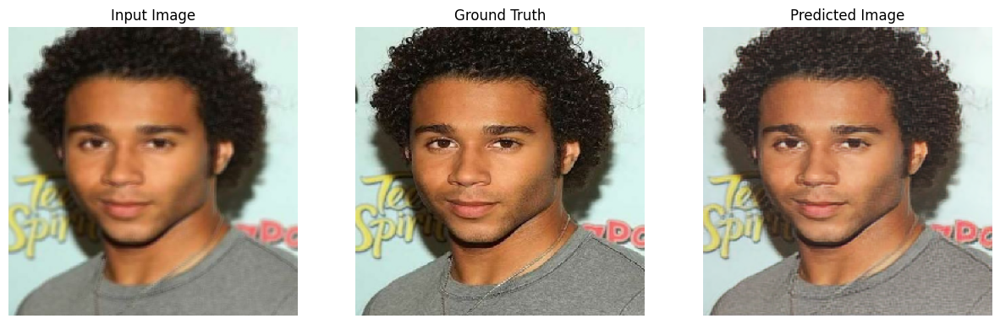

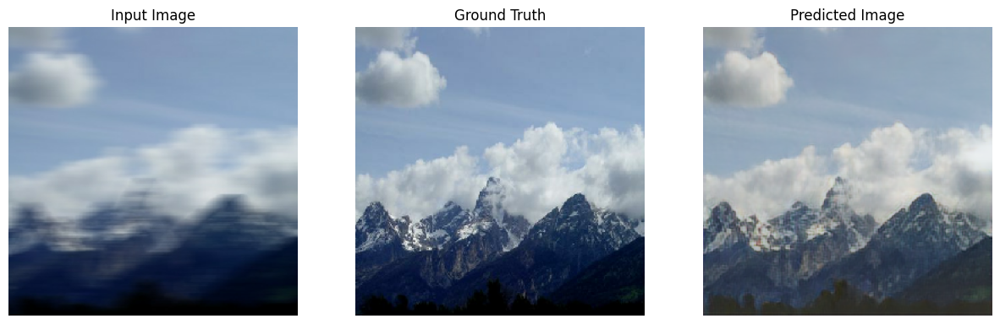

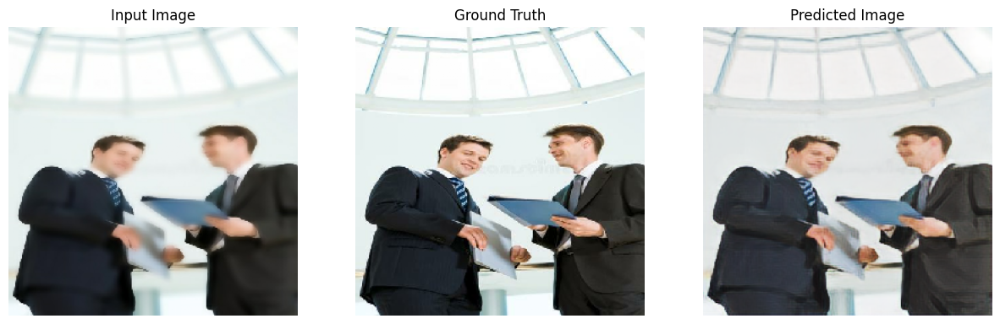

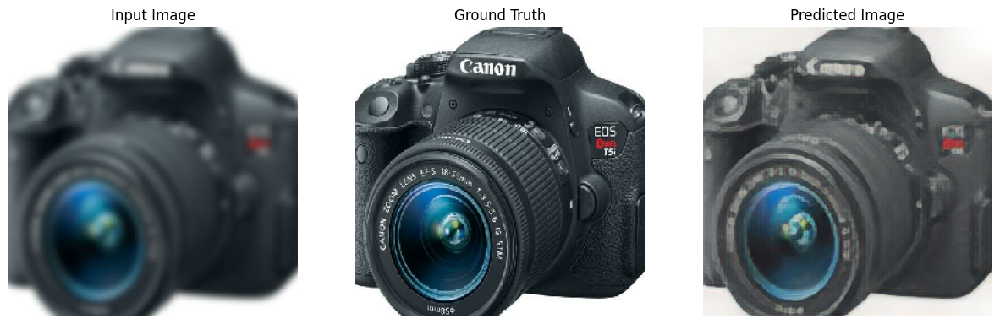

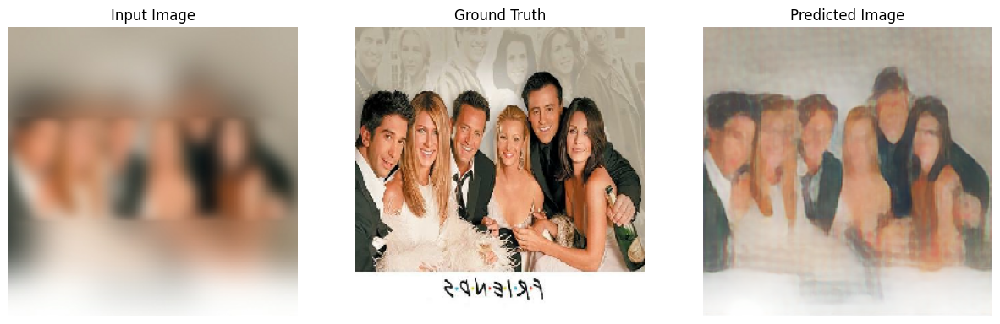

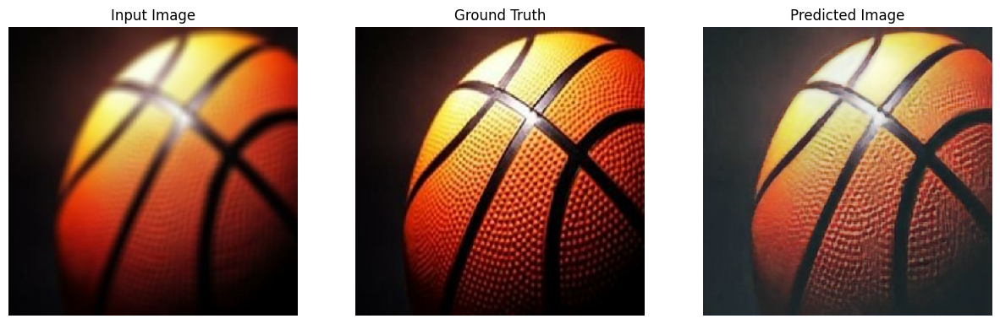

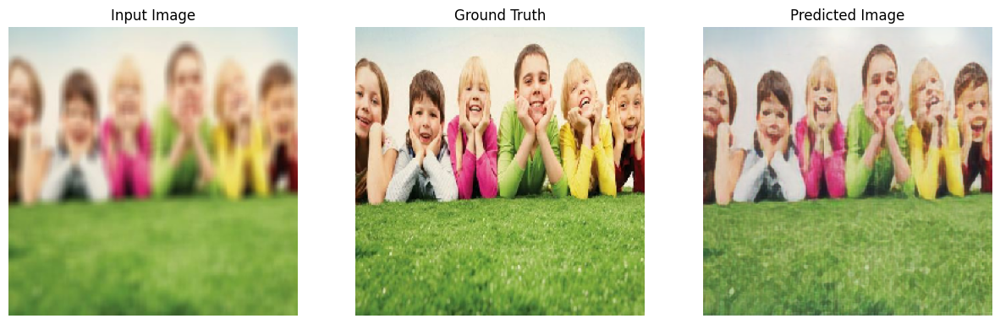

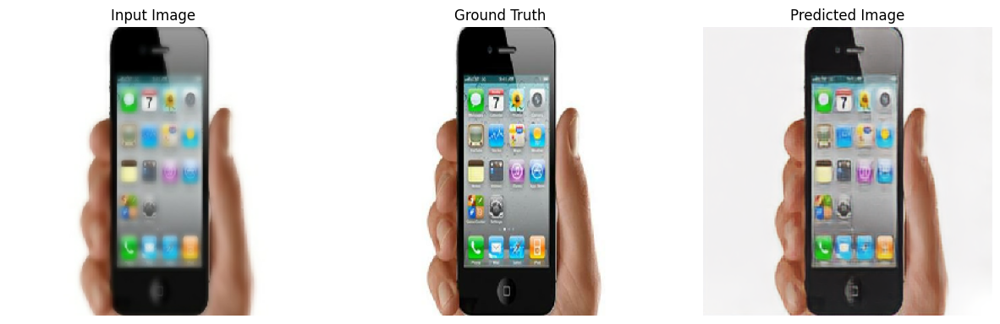

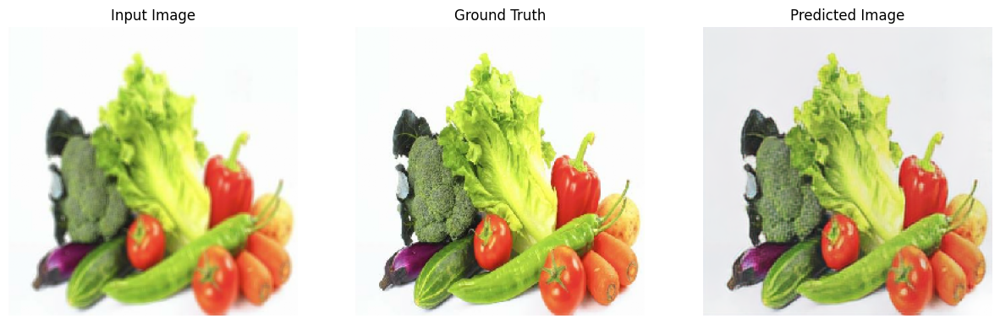

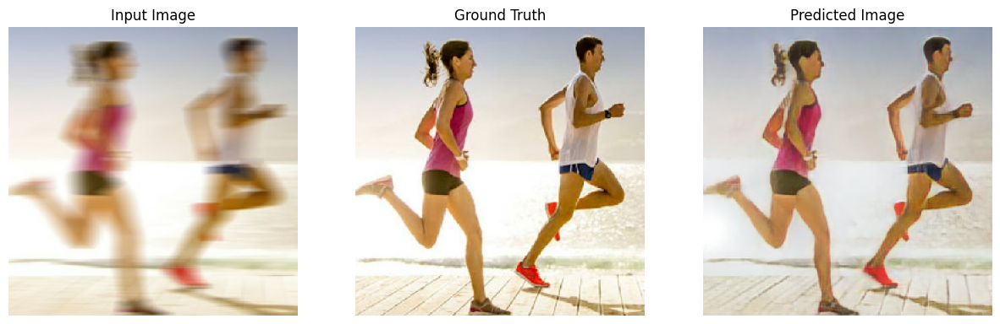

In [107]:
for inp, tar in train_dataset.take(10):
  generate_images(generator, inp, tar)

#### **`Performance on Testing Data`**

* Here, we `generate images` using our model on `unseen data`.

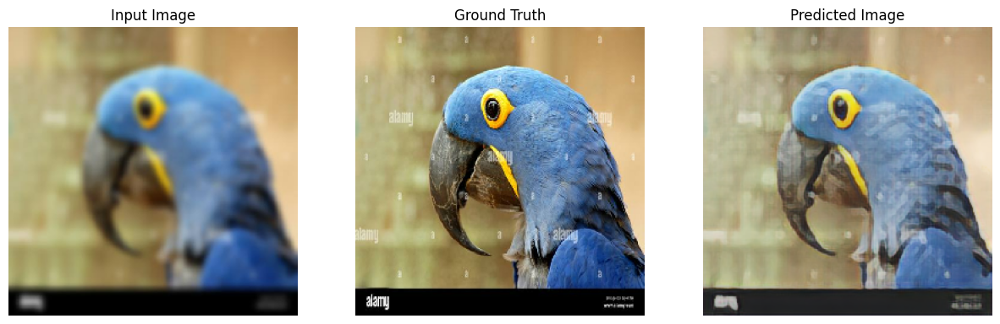

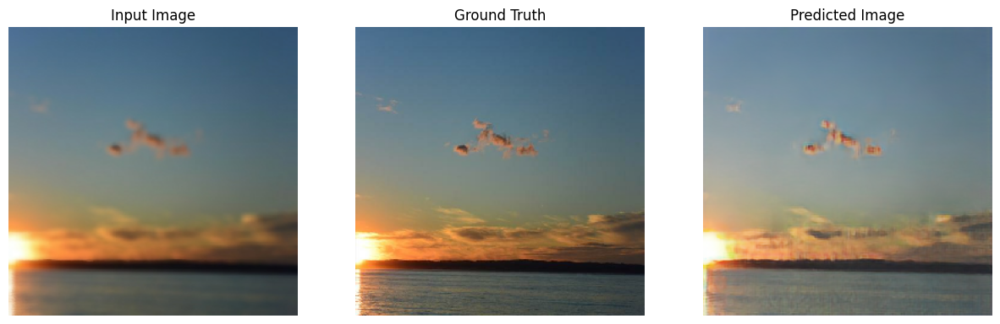

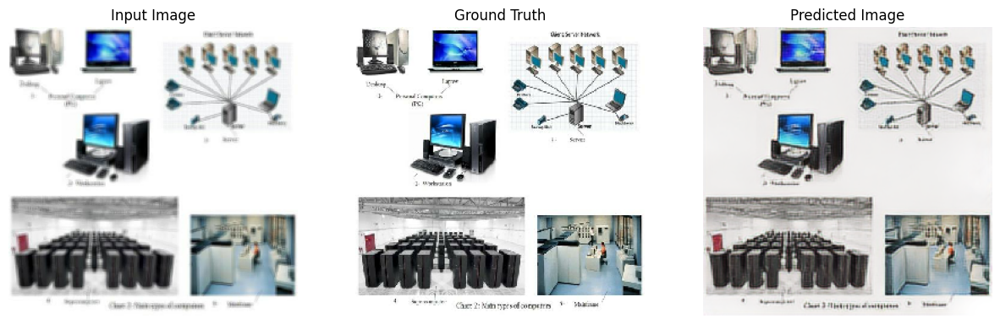

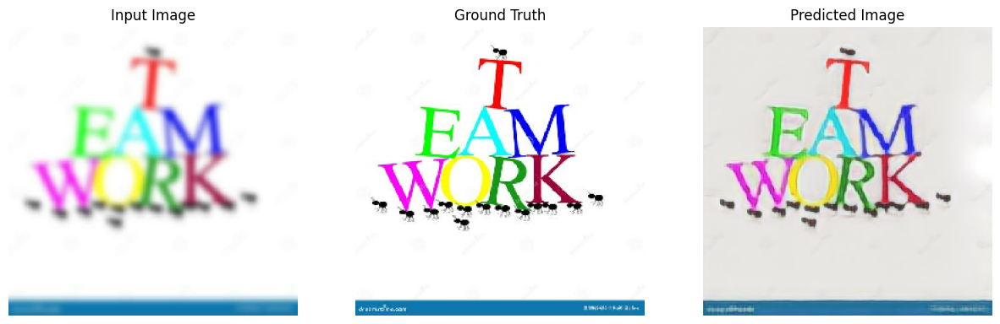

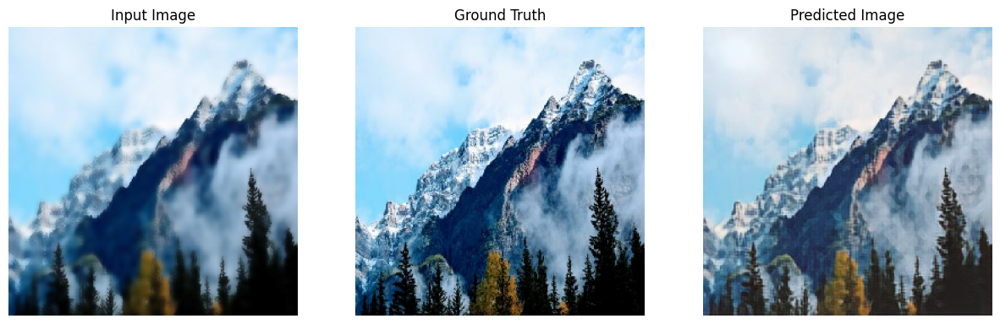

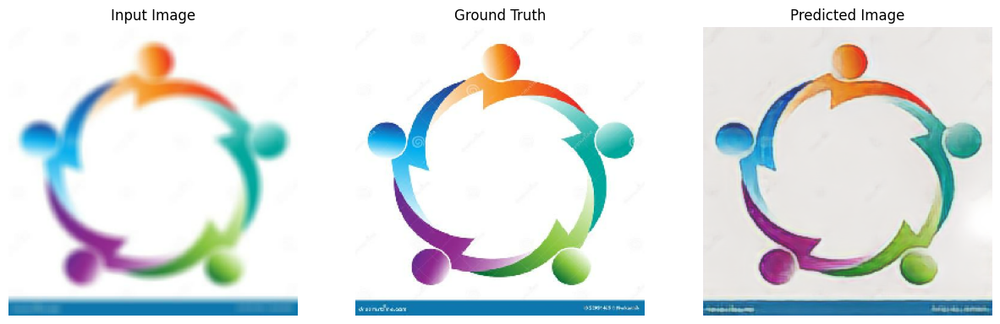

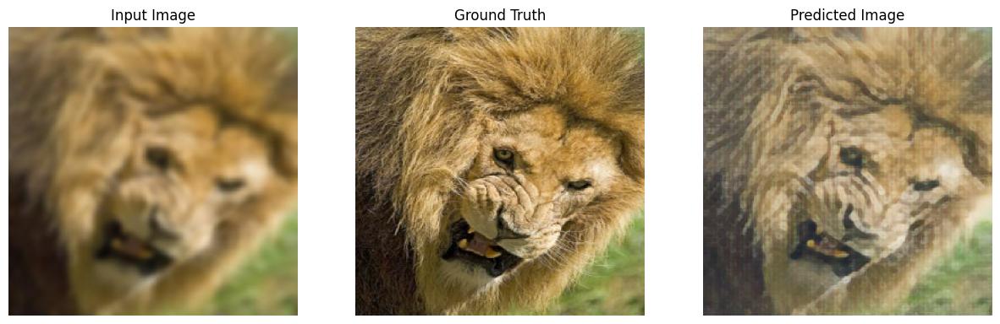

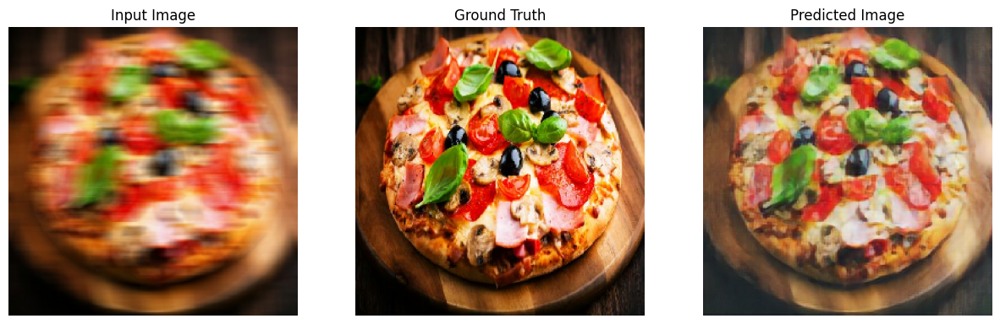

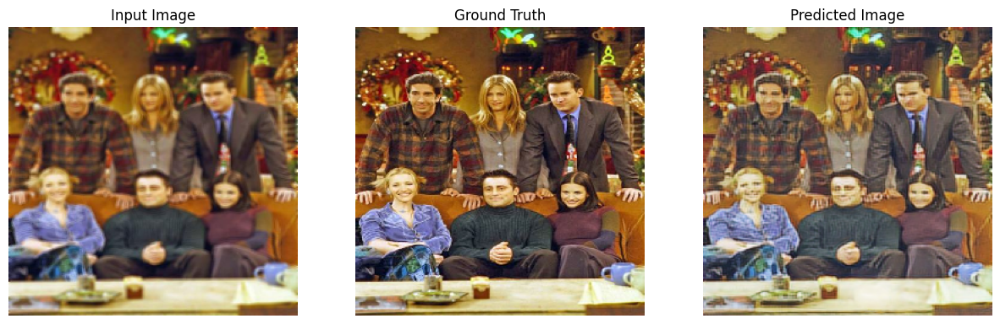

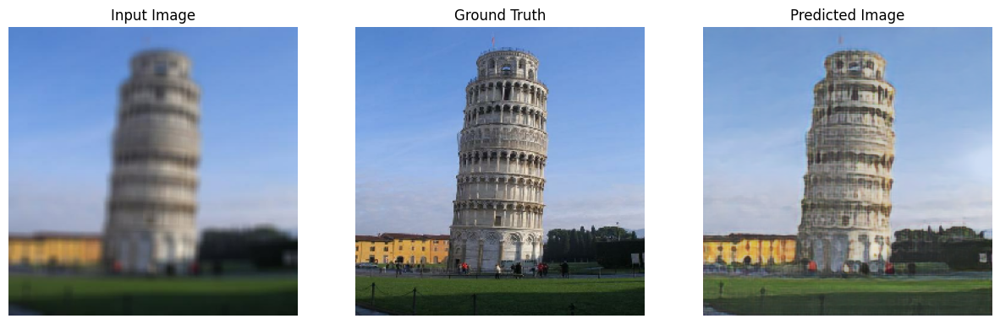

In [108]:
for inp, tar in test_dataset.take(10):
  generate_images(generator, inp, tar)

* The model seem to be doing a pretty good job on both `seen` and `unseen` data.


'''

#### **`SSIM and PSNR metrics for Generation Accuracy`**

> `SSIM (Structural Similarity Index Measure)` and `PSNR (Peak Signal-to-Noise Ratio)` are two commonly used metrics for measuring the `quality of generated images` in Deep Convolutional Generative Adversarial Networks (`DCGAN`s).

* `SSIM` is used to determine how `similar two images` are, by taking into account the luminance, contrast, and structure of the images. `Larger SSIM` values indicate `better image quality` and clarity; smaller SSIM values indicate image blurriness and poor visual quality.

* `PSNR` is a measure of image quality after `denoising` or noise addition. It compares a noisy or distorted image to a reference image, typically by calculating the `mean squared error` between the two images. `Larger PSNR` values indicate `better image quality` and clarity; smaller PSNR values indicate image blurriness and poor visual quality 1.

**`Calculate SSIM and PSNR on Training dataset`**

In [109]:
ssims = []
for inp, tar in train_dataset.take(30):
    ssim = tf.image.ssim(tar, generator(inp), max_val=1, filter_size=11,
                              filter_sigma=1.5, k1=0.01, k2=0.03)
    ssims.append(ssim)
tf.reduce_mean(ssims)

<tf.Tensor: shape=(), dtype=float32, numpy=0.52870536>

In [110]:
psnrs = []
for inp, tar in train_dataset.take(30):
    psnr = tf.image.psnr(tar, generator(inp), max_val=1)
    psnrs.append(psnr)
tf.reduce_mean(psnrs)

<tf.Tensor: shape=(), dtype=float32, numpy=12.792228>

**`Calculate SSIM and PSNR on Test dataset`**

In [111]:
ssims = []
for inp, tar in test_dataset.take(30):
    ssim = tf.image.ssim(tar, generator(inp), max_val=1, filter_size=11,
                              filter_sigma=1.5, k1=0.01, k2=0.03)
    ssims.append(ssim)
tf.reduce_mean(ssims)

<tf.Tensor: shape=(), dtype=float32, numpy=0.43679538>

In [112]:
psnrs = []
for inp, tar in test_dataset.take(30):
    psnr = tf.image.psnr(tar, generator(inp), max_val=1)
    psnrs.append(psnr)
tf.reduce_mean(psnrs)

<tf.Tensor: shape=(), dtype=float32, numpy=13.457432>

***
***